In [1]:
import pandas as pd
import numpy as np

In [2]:
import seaborn as sns

In [3]:
import textract

In [4]:
import re

In [5]:
import nltk

In [6]:
from nltk import sent_tokenize
from nltk import word_tokenize

In [7]:
import matplotlib.pyplot as plt

In [8]:
julio=pd.read_excel('gcdm_case_study___reviews_of_july.xlsx')

In [9]:
julio

,Public review (translated),Private review (translated),Stars general,Stars arrival,Stars cleaning,Stars communication,Stars precision,Stars value,Stars location,Type of guest,Building Code,Apartment Number,Country,Date of checkout,Number of nights stayed
0,Very good,NaN,4,-,-,-,-,-,-,New,BEF 175,102,Mexico,2021-07-01,3
1,Exceptional! DISLIKED: The iron did not work. ...,NaN,5,-,-,-,-,-,-,New,BEF 175,403,Mexico,2021-07-01,4
2,Excellent,NaN,5,-,-,-,-,-,-,New,CAM 428,4,Mexico,2021-07-01,2
3,Wonderful! We really enjoyed the stay there an...,NaN,5,-,-,-,-,-,-,New,JVM 429,A 11-12,Mexico,2021-07-01,5
4,My favourite Airbnb ever! I loved it! It was m...,NaN,5,5,5,5,5,5,5,New,JVM 429,B 01,Mexico,2021-07-01,7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
161,"Very good location in Polanco neighborhood, wi...",Muchas gracias Rosalia Dawn. I appreciate your...,5,5,5,5,5,5,5,New,PLA 126,201,Mexico,2021-07-14,7
162,Luiz's apartment received us with open arms .....,NaN,5,5,5,5,5,5,5,New,RAI 1400,16,Brazil,2021-07-14,7
163,All very good! Surpassed my expectations and n...,Everything perfect and even better than I expe...,5,5,5,5,5,5,5,Returning,UBR 1577,107,Brazil,2021-07-14,1
164,Everything was wonderful!,NaN,5,5,5,5,5,5,5,New,BEF 175,101,Mexico,2021-07-15,9


In [10]:
julio.dtypes

Public review (translated)             object
Private review (translated)            object
Stars general                           int64
Stars arrival                          object
Stars cleaning                         object
Stars communication                    object
Stars precision                        object
Stars value                            object
Stars location                         object
Type of guest                          object
Building Code                          object
Apartment Number                       object
Country                                object
Date of checkout               datetime64[ns]
Number of nights stayed                 int64
dtype: object

In [11]:
from nltk.corpus import stopwords

In [12]:
texto_publico=list(julio['Public review (translated)'].apply(str).values+' *= '+julio['Stars general'].apply(str).values)

In [13]:
texto_privado=list(julio['Private review (translated)'].apply(str).values+' *= '+julio['Stars general'].apply(str).values)

In [14]:
#nltk.download('stopwords')

In [15]:
stop_en=stopwords.words('english')

In [16]:
lista_2=[' *=','*=','*= ',' *= ','nan*=','1','2','3','4','5']

In [17]:
for i in lista_2:
    stop_en.append(i)

In [18]:
#nltk.download('punkt')

In [19]:
#publico
t=[]
for i in texto_publico:
    t.append(i.split())
    
palabras = []
for sublist in t:
    for item in sublist:
        palabras.append(item.lower())

In [20]:
clean_words_julio = []

for w in palabras:
    if w not in stop_en:
        clean_words_julio.append(w)
        
clean_words_julio

['good',
 'exceptional!',
 'disliked:',
 'iron',
 'work.',
 'rest,',
 'perfect',
 'excellent',
 'wonderful!',
 'really',
 'enjoyed',
 'stay',
 'would',
 'definitely',
 'come',
 'back',
 'liked:',
 'location',
 'unbeatable',
 'apartment',
 'beautiful',
 'nice',
 'view.',
 'would',
 'highly',
 'recommend',
 'come',
 'back',
 'again.',
 'favourite',
 'airbnb',
 'ever!',
 'loved',
 'it!',
 'modern,',
 'spacious,',
 'clean,',
 'cozy.',
 'everything',
 'need.',
 'location',
 'great,',
 'rosalia',
 'amazing',
 'even',
 'left',
 'us',
 'popcorn',
 'arrived.',
 'strongly',
 'recommend!',
 'amazing',
 'bedroom',
 'apartment,',
 "i'm",
 'love',
 'it!',
 'unbeatable',
 'location',
 'amazing',
 'experience!',
 'perfect',
 'place',
 'solo',
 'traveler.',
 'cost',
 'effective',
 'space',
 'perfectly',
 'optimized.',
 'able',
 'cook',
 'couch',
 'good',
 'enough',
 'one.',
 'bed',
 'large',
 'comfortable.',
 'temperature',
 'decently',
 'regulated',
 'even',
 'without',
 'a/c.',
 'tv',
 'netflix.',
 '

In [21]:
from nltk.probability import FreqDist

In [22]:
fdist = FreqDist(clean_words_julio)

In [23]:
fdist.most_common()

[('great', 64),
 ('apartment', 46),
 ('stay', 40),
 ('super', 34),
 ('well', 32),
 ('place', 30),
 ('excellent', 28),
 ('location', 28),
 ('everything', 27),
 ('perfect', 24),
 ('good', 22),
 ('recommend', 21),
 ('would', 20),
 ('clean', 19),
 ('luiz', 18),
 ('apartment,', 16),
 ('casai', 16),
 ('host', 14),
 ('always', 14),
 ('building', 13),
 ('could', 13),
 ('location,', 13),
 ('beautiful', 12),
 ('nice', 12),
 ('clean,', 12),
 ('check', 12),
 ('best', 12),
 ('many', 12),
 ('highly', 11),
 ('great,', 11),
 ('even', 11),
 ('stay.', 11),
 ('located', 11),
 ('like', 11),
 ('really', 10),
 ('amazing', 10),
 ('space', 10),
 ('definitely', 9),
 ('back', 9),
 ('loved', 9),
 ('us', 9),
 ('room', 9),
 ('walking', 9),
 ('location.', 9),
 ('one', 9),
 ('service', 9),
 ('restaurants', 9),
 ('communication', 9),
 ('roma', 8),
 ('within', 8),
 ('security', 8),
 ('get', 8),
 ('comfortable,', 8),
 ('bit', 8),
 ('close', 8),
 ('experience', 8),
 ('next', 8),
 ('airbnb', 7),
 ('also', 7),
 ('stay!', 

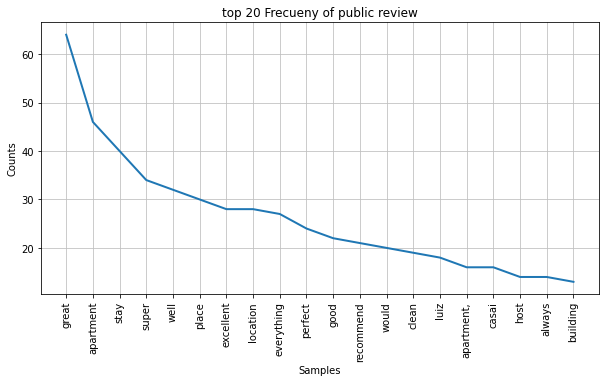

<Figure size 432x288 with 0 Axes>

In [24]:
fig = plt.figure(figsize = (10,5))
plt.ion()

fdist.plot(20,title='top 20 Frecueny of public review')

plt.savefig('top20_public.png')

In [25]:
#privado
u=[]
for i in texto_privado:
    u.append(i.split())
    
palabras2 = []
for sublist in u:
    for item in sublist:
        palabras2.append(item.lower())

In [26]:
clean_words_julioprivado = []

for w in palabras2:
    if w not in stop_en:
        clean_words_julioprivado.append(w)
        
clean_words_julioprivado

['nan',
 'nan',
 'nan',
 'nan',
 'nan',
 'perfect!',
 'fyi,',
 'elevator',
 'working',
 'nobody',
 'told',
 'us',
 'it.',
 'bit',
 'struggle',
 'us,',
 'building',
 'guard',
 'super',
 'nice',
 'help',
 'us',
 'bags.',
 'doors',
 'bad.',
 'hard',
 'close',
 'flimsy',
 'provide',
 'sense',
 'security.',
 'please',
 'consider',
 'replacing',
 'proper',
 'doors.',
 'nan',
 'nan',
 'nan',
 'thanks',
 'flexibility',
 'professionalism,',
 'keep',
 'up!',
 'super',
 'good',
 'building',
 'staff',
 'too!a',
 'detail',
 'noticed',
 'last',
 'days',
 'affect',
 'us:',
 'work',
 'neighbor',
 'day.',
 'worth',
 'checking',
 'guests',
 'could',
 'annoyed',
 'future',
 'work',
 'still',
 'going',
 'on.',
 'nan',
 'massive',
 'thanks',
 'everything!',
 'nan',
 'nan',
 'luiz,',
 'thank',
 'speed',
 'stay',
 'there.',
 'thanks',
 'also',
 'patience.',
 'great',
 'days.',
 'nan',
 'thanks!',
 'nan',
 'nan',
 'thanks',
 'luiz!!',
 "we're",
 'counting',
 'next',
 'time',
 ':)',
 'nan',
 'thanks',
 'us',
 

In [27]:
fdprivado = FreqDist(clean_words_julioprivado)

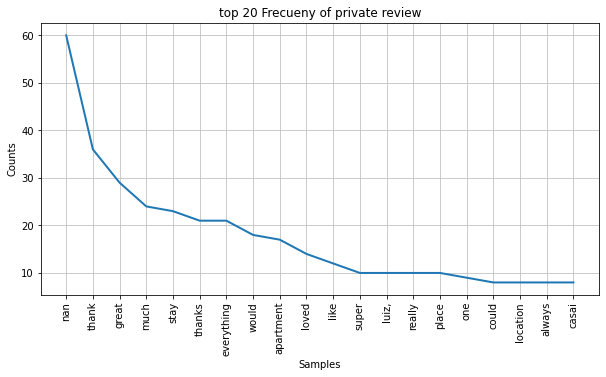

<AxesSubplot:title={'center':'top 20 Frecueny of private review'}, xlabel='Samples', ylabel='Counts'>

In [28]:
fig = plt.figure(figsize = (10,5))


fdprivado.plot(20,title='top 20 Frecueny of private review')



In [29]:
from wordcloud import WordCloud

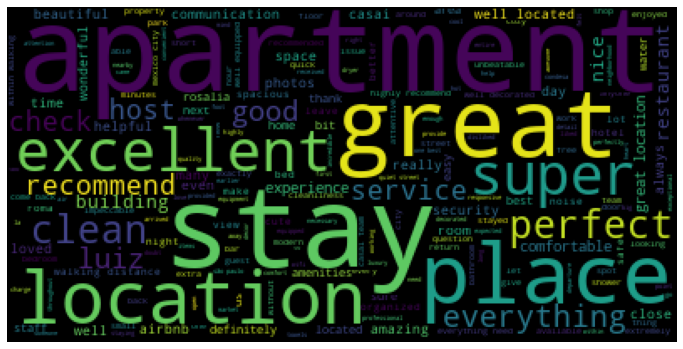

In [30]:
word_cloud = WordCloud().generate(" ".join(clean_words_julio))

plt.figure(figsize = (12,12))

plt.imshow(word_cloud)

plt.axis('off')

plt.show();

In [31]:
from textblob import TextBlob

In [32]:
positivo_publico=[]
negativo_publico=[]
neutral_publico=[]
for i in texto_publico:
    j=TextBlob(i).sentiment
    
    if j.polarity==0:
        neutral_publico.append(i)
    elif j.polarity<0:
        negativo_publico.append(i)
    elif j.polarity>0:
        positivo_publico.append(i)

In [33]:
positivo_privado=[]
negativo_privado=[]
neutral_privado=[]
for i in texto_privado:
    j=TextBlob(i).sentiment

    if j.polarity==0:
        neutral_privado.append(i)
    elif j.polarity<0:
        negativo_privado.append(i)
    elif j.polarity>0:
        positivo_privado.append(i)

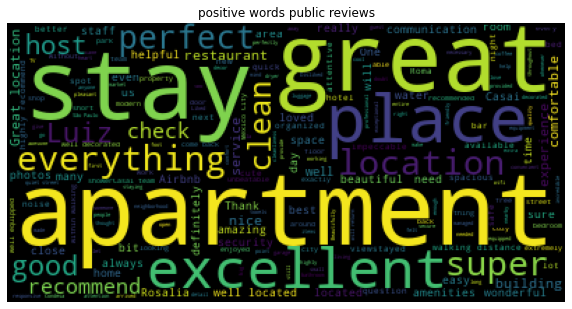

In [34]:
nube_positivo_publico = WordCloud().generate(" ".join(positivo_publico))

plt.figure(figsize = (10,12))

plt.imshow(nube_positivo_publico)
plt.title('positive words public reviews')

plt.axis('off')

plt.show();

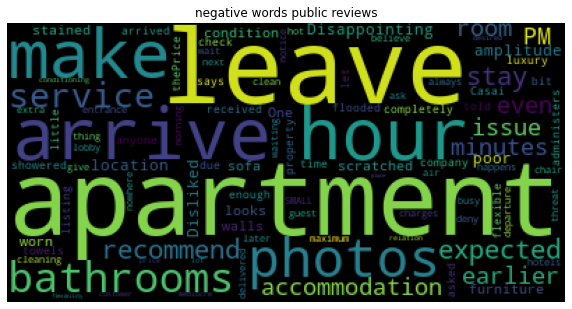

In [35]:
nube_negativo_publico = WordCloud().generate(" ".join(negativo_publico))

plt.figure(figsize = (10,12))

plt.imshow(nube_negativo_publico)
plt.title('negative words public reviews')

plt.axis('off')

plt.show();

In [36]:
for i in negativo_publico:
    if re.search('leave',i):
        print(i, '\n')

The accommodation is as the photos are, however I would have expected that for thePrice were a bit more flexible. They do not let you arrive 1 hour before the check-in time, I asked if I could arrive a little earlier and they told me no due to cleaning issues, when the accommodation makes you leave it at 11 AM and the next guest's entrance is at 3 PM. I can't believe that in 4 hours they can't clean the apartment which is VERY SMALL. Not even the hotels deny you arrive earlier like here.The same thing happens with the issue of departure, they make you leave at 11 in the morning, just ask if I could leave an hour later and they give you a threat and notice of 15 minutes maximum (11:15) because if they do not make you extra charges.The lobby has no more than 1 “waiting room” chair and is always busy. There is nowhere to be to wait for your room to be delivered, why don't you get it even 5 minutes before 3:00 PM.The apartment is very hot and does not have air conditioning.My stay was medi

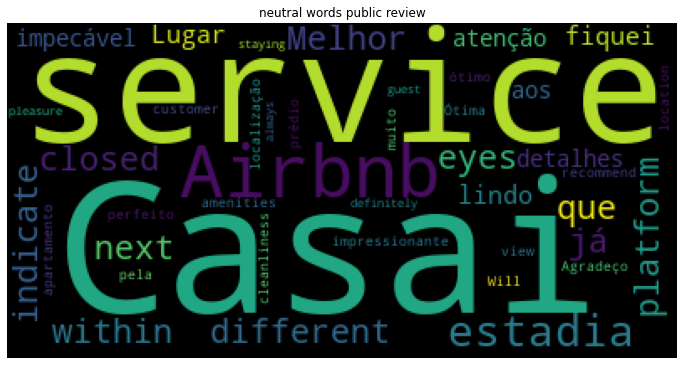

In [37]:
nube_neutral_publico = WordCloud().generate(" ".join(neutral_publico))

plt.figure(figsize = (12,12))

plt.imshow(nube_neutral_publico)
plt.title('neutral words public review')

plt.axis('off')

plt.show();

In [38]:
for i in neutral_publico:
    if re.search('casai',i.lower()):
        print(i, '\n')

Casai has a different service within the Airbnb platform, I indicate with my eyes closed.To the next!! *= 5 

Melhor estadia que já fiquei no Airbnb. Lugar lindo e impecável, a atenção aos detalhes é impressionante. Ótima localização, ótimo prédio e o apartamento é perfeito. Agradeço muito a Casai pela estadia. *= 5 



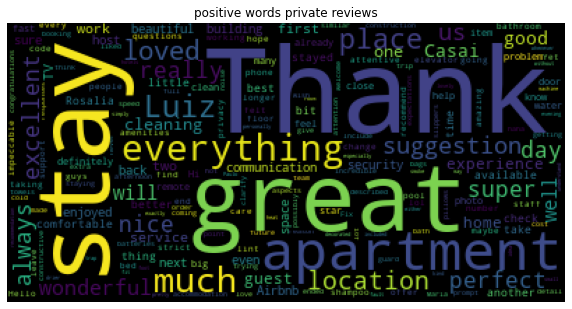

In [39]:
nube_positivo_privado = WordCloud().generate(" ".join(positivo_privado))

plt.figure(figsize = (10,12))

plt.imshow(nube_positivo_privado)
plt.title('positive words private reviews')
plt.axis('off')

plt.show();

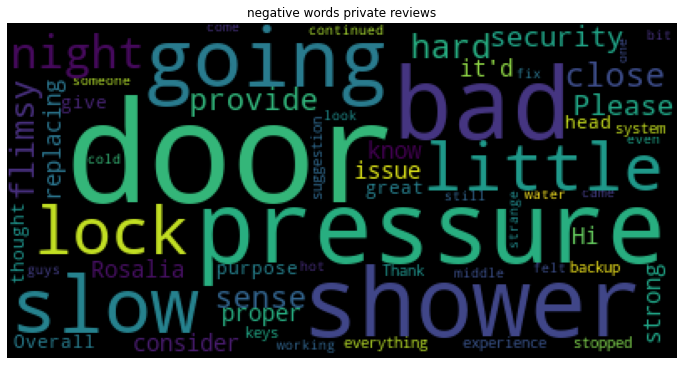

In [40]:
nube_negativo_privado = WordCloud().generate(" ".join(negativo_privado))

plt.figure(figsize = (12,12))

plt.imshow(nube_negativo_privado)

plt.title('negative words private reviews')

plt.axis('off')

plt.show();

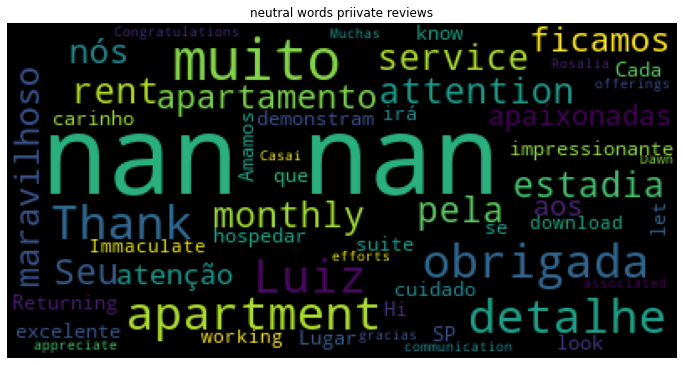

In [41]:
nube_neutral_privado = WordCloud().generate(" ".join(neutral_privado))

plt.figure(figsize = (12,12))

plt.imshow(nube_neutral_privado)


plt.title('neutral words priivate reviews')

plt.axis('off')

plt.show();

In [42]:
for i in neutral_privado:
    print(i)

nan *= 4
nan *= 5
nan *= 5
nan *= 5
nan *= 5
nan *= 4
nan *= 5
nan *= 5
nan *= 2
nan *= 5
nan *= 5
nan *= 5
nan *= 5
nan *= 5
nan *= 5
nan *= 5
nan *= 5
nan *= 5
nan *= 5
nan *= 4
nan *= 5
nan *= 5
nan *= 5
nan *= 5
nan *= 5
nan *= 5
nan *= 5
nan *= 5
nan *= 5
nan *= 5
nan *= 5
nan *= 5
nan *= 1
nan *= 5
nan *= 5
Thank you for all the service and attention! Do you rent monthly? *= 5
THANK YOU *= 5
nan *= 5
Luiz, muito obrigada pela estadia! Seu apartamento é maravilhoso, nós ficamos apaixonadas. A atenção aos detalhes é impressionante. Amamos muito, muito obrigada. *= 5
nan *= 5
nan *= 5
Returning to SP I'll look for you again! *= 5
nan *= 5
nan *= 5
nan *= 5
Lugar excelente. Cada detalhe demonstram carinho e cuidado com que irá se hospedar. *= 5
nan *= 5
nan *= 5
nan *= 5
Hi Luiz, just to let you know that the suite download is not working. *= 5
nan *= 2
nan *= 4
nan *= 5
nan *= 5
nan *= 5
nan *= 5
nan *= 5
nan *= 5
nan *= 5
nan *= 5
nan *= 5
nan *= 4
nan *= 3
nan *= 5
Immaculate apar

In [43]:
julio['Stars general'].mean()

4.873493975903615

<AxesSubplot:>

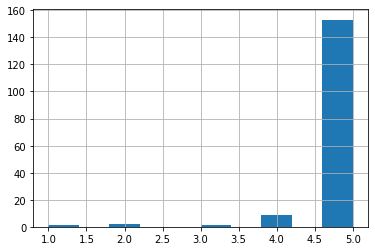

In [44]:
julio['Stars general'].hist()

Text(0.5, 1.0, 'histogram records vs general starts')

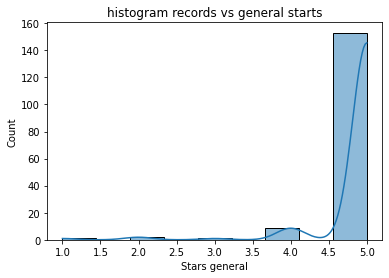

In [45]:
sns.histplot(julio['Stars general'], kde=True,).set_title("histogram records vs general starts")

<AxesSubplot:ylabel='Stars general'>

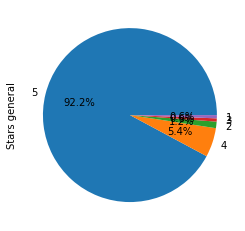

In [46]:
julio['Stars general'].value_counts().plot(kind='pie',autopct='%1.1f%%')

In [47]:
julio_4=julio[julio['Stars general']==4]
julio_4

,Public review (translated),Private review (translated),Stars general,Stars arrival,Stars cleaning,Stars communication,Stars precision,Stars value,Stars location,Type of guest,Building Code,Apartment Number,Country,Date of checkout,Number of nights stayed
0,Very good,NaN,4,-,-,-,-,-,-,New,BEF 175,102,Mexico,2021-07-01,3
7,We enjoyed our stay. Liked: The space is great...,NaN,4,-,-,-,-,-,-,New,PUE 313,101,Mexico,2021-07-01,1
34,Strengths: excellent structure! Quick host res...,NaN,4,3,4,4,5,5,5,New,UBR 1577,111,Brazil,2021-07-02,4
62,"The space is like in the photos: beautiful, cl...","Hi Luiz, you were always very attentive but th...",4,4,3,5,3,5,4,New,UBR 1577,46,Brazil,2021-07-04,3
74,Loved the stay here! Casai was great!! I wish ...,Loved the stay here! Alberto was great!! I wis...,4,5,4,5,5,5,4,New,TUM,VPA 202 (D),Mexico,2021-07-05,4
77,"Apartment very well decorated and comfortable,...","Luiz, thank you for your hospitality and fast ...",4,3,4,4,5,5,5,New,UBR 1577,72,Brazil,2021-07-05,4
80,The apartment was very small but cute with all...,"Dear Rosalia, looks like my review period is c...",4,5,3,5,4,5,5,New,BEF 175,301,Mexico,2021-07-06,4
134,The space is beautifully decorated and well lo...,NaN,4,5,3,3,2,3,5,New,UBR 1577,46,Brazil,2021-07-11,2
155,"Very clean, comfortable, and safe apartment. T...",NaN,4,4,4,5,5,5,4,New,QRO 240,904,Mexico,2021-07-13,6


In [48]:
julio_4

,Public review (translated),Private review (translated),Stars general,Stars arrival,Stars cleaning,Stars communication,Stars precision,Stars value,Stars location,Type of guest,Building Code,Apartment Number,Country,Date of checkout,Number of nights stayed
0,Very good,NaN,4,-,-,-,-,-,-,New,BEF 175,102,Mexico,2021-07-01,3
7,We enjoyed our stay. Liked: The space is great...,NaN,4,-,-,-,-,-,-,New,PUE 313,101,Mexico,2021-07-01,1
34,Strengths: excellent structure! Quick host res...,NaN,4,3,4,4,5,5,5,New,UBR 1577,111,Brazil,2021-07-02,4
62,"The space is like in the photos: beautiful, cl...","Hi Luiz, you were always very attentive but th...",4,4,3,5,3,5,4,New,UBR 1577,46,Brazil,2021-07-04,3
74,Loved the stay here! Casai was great!! I wish ...,Loved the stay here! Alberto was great!! I wis...,4,5,4,5,5,5,4,New,TUM,VPA 202 (D),Mexico,2021-07-05,4
77,"Apartment very well decorated and comfortable,...","Luiz, thank you for your hospitality and fast ...",4,3,4,4,5,5,5,New,UBR 1577,72,Brazil,2021-07-05,4
80,The apartment was very small but cute with all...,"Dear Rosalia, looks like my review period is c...",4,5,3,5,4,5,5,New,BEF 175,301,Mexico,2021-07-06,4
134,The space is beautifully decorated and well lo...,NaN,4,5,3,3,2,3,5,New,UBR 1577,46,Brazil,2021-07-11,2
155,"Very clean, comfortable, and safe apartment. T...",NaN,4,4,4,5,5,5,4,New,QRO 240,904,Mexico,2021-07-13,6


In [49]:
#exporto
julio_4.to_excel('Cuatro_estrellas.xlsx')

In [50]:
def my_fmt(x):
    print(x)
    return '{:.4f}%\n({:.0f})'.format(x, total*x/100)

44.44444477558136
22.22222238779068
11.11111119389534
11.11111119389534
11.11111119389534


<AxesSubplot:title={'center':'Buildings with 4 stars'}, ylabel='Building Code'>

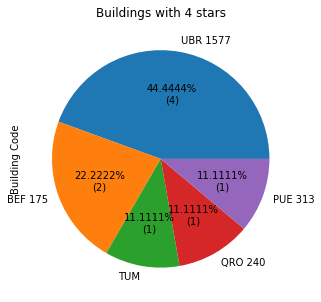

In [51]:
fig = plt.figure(figsize = (10,5))
total = len(julio_4['Building Code'])
julio_4['Building Code'].value_counts().plot(kind='pie',autopct=my_fmt, title='Buildings with 4 stars',)

In [52]:
for i in julio[julio['Stars general']==4]['Public review (translated)']:
    print(julio[julio['Public review (translated)']==i]['Building Code'],i,'\n')

0    BEF 175
Name: Building Code, dtype: object Very good  

7    PUE 313
Name: Building Code, dtype: object We enjoyed our stay. Liked: The space is great. The building is very nice and the decor in the room is perfect. Disliked: The bed could be more comfortable. Also the bathroom had a bad smell. 

34    UBR 1577
Name: Building Code, dtype: object Strengths: excellent structure! Quick host responses. Super convenient check-in and check-out. Negative point: the apartment wasn't super clean, could have been better, floor was a bit dusty. 

62    UBR 1577
Name: Building Code, dtype: object The space is like in the photos: beautiful, clean and organized. I had some small setbacks: There was no possibility to check in earlier and there was no place to leave the bags.... the same happened at check out. Split only cools, there's no heat function. Fortunately, the next day they gave us an extra blanket. It was very cold in Sao Paulo on the date of my stay. The sheets are good but the qualit

In [53]:
julio_3=julio[julio['Stars general']<=3]

In [54]:
julio_3

,Public review (translated),Private review (translated),Stars general,Stars arrival,Stars cleaning,Stars communication,Stars precision,Stars value,Stars location,Type of guest,Building Code,Apartment Number,Country,Date of checkout,Number of nights stayed
11,Disappointing Like: amplitude and location. Di...,NaN,2,-,-,-,-,-,-,New,TEM 40,201/202,Mexico,2021-07-01,1
87,DO NOT BOOK THIS PLACE. Few things to note:* T...,NaN,1,1,1,1,5,1,5,New,TEM 40,303,Mexico,2021-07-06,5
132,"The accommodation is as the photos are, howeve...",NaN,2,5,1,4,1,1,2,New,TON 30,PH2,Mexico,2021-07-11,2
156,Apartment was fine. Coordination with the host...,NaN,3,5,4,5,3,3,5,New,TON 30,603,Mexico,2021-07-13,4


In [55]:
#exporto
julio_3.to_excel('tres_estrellas.xlsx')

50.0
50.0


<AxesSubplot:title={'center':'Buildings with 3 or less stars'}, ylabel='Building Code'>

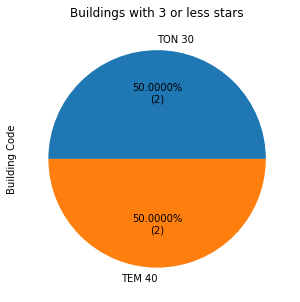

In [56]:
fig = plt.figure(figsize = (10,5))
total = len(julio_3['Building Code'])
julio_3['Building Code'].value_counts().plot(kind='pie',autopct=my_fmt,title='Buildings with 3 or less stars')

In [57]:
for i in julio[julio['Stars general']<=3]['Public review (translated)']:
    print(julio[julio['Public review (translated)']==i]['Building Code'],i, '\n')

11    TEM 40
Name: Building Code, dtype: object Disappointing Like: amplitude and location. Disliked: The apartment is in poor condition, it is not as it looks in the photos. All furniture is scratched and worn. The sofa and the walls were stained. One of the bathrooms would get completely flooded when we showered. When we arrived there were not enough towels in the bathrooms. The service we received from Casai, the company that administers the property, was not what we expected. I would not stay here again or would not I recommend it to anyone. It is not a luxury apartment as it says in the listing. 

87    TEM 40
Name: Building Code, dtype: object DO NOT BOOK THIS PLACE. Few things to note:* This is not a managed property or a boutique hotel as it claims to be. None of the Casai properties are.* This property will charge a $25 fee to clean your room every day. This service is free at a hotel but not here.* This property will charge a $10 fee to replace your towels and bed sheets ever

# por edificio

In [58]:
julio['Building Code'].value_counts()

UBR 1577    62
TON 30      17
JVM 429     10
COR 131      9
BEF 175      8
PUE 313      8
CAM 428      7
TEM 40       7
RPQ 111      6
EAP 335      4
RAI 1400     4
QRO 240      3
PLA 126      3
TUM          3
IAR 84       2
JML 534      2
PDM 1375     2
BER 391      2
ACA 10B      2
ROM 4        1
ARI 103      1
HOM 1433     1
QRO 205      1
EAP 362      1
Name: Building Code, dtype: int64

<AxesSubplot:ylabel='Building Code'>

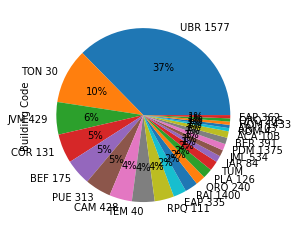

In [59]:
julio['Building Code'].value_counts().plot(kind='pie',autopct='%1.0f%%')

In [60]:
lista_edificios=list(julio['Building Code'].value_counts().index)

In [61]:
lista_edificios

['UBR 1577',
 'TON 30',
 'JVM 429',
 'COR 131',
 'BEF 175',
 'PUE 313',
 'CAM 428',
 'TEM 40',
 'RPQ 111',
 'EAP 335',
 'RAI 1400',
 'QRO 240',
 'PLA 126',
 'TUM',
 'IAR 84',
 'JML 534',
 'PDM 1375',
 'BER 391',
 'ACA 10B',
 'ROM 4',
 'ARI 103',
 'HOM 1433',
 'QRO 205',
 'EAP 362']

In [62]:
julio['Building Code'].value_counts()

UBR 1577    62
TON 30      17
JVM 429     10
COR 131      9
BEF 175      8
PUE 313      8
CAM 428      7
TEM 40       7
RPQ 111      6
EAP 335      4
RAI 1400     4
QRO 240      3
PLA 126      3
TUM          3
IAR 84       2
JML 534      2
PDM 1375     2
BER 391      2
ACA 10B      2
ROM 4        1
ARI 103      1
HOM 1433     1
QRO 205      1
EAP 362      1
Name: Building Code, dtype: int64

In [63]:
def limpio(x):
    try:
        j=(str(x).replace('-',''))
        return j
    except:
        pass

In [64]:
julio

,Public review (translated),Private review (translated),Stars general,Stars arrival,Stars cleaning,Stars communication,Stars precision,Stars value,Stars location,Type of guest,Building Code,Apartment Number,Country,Date of checkout,Number of nights stayed
0,Very good,NaN,4,-,-,-,-,-,-,New,BEF 175,102,Mexico,2021-07-01,3
1,Exceptional! DISLIKED: The iron did not work. ...,NaN,5,-,-,-,-,-,-,New,BEF 175,403,Mexico,2021-07-01,4
2,Excellent,NaN,5,-,-,-,-,-,-,New,CAM 428,4,Mexico,2021-07-01,2
3,Wonderful! We really enjoyed the stay there an...,NaN,5,-,-,-,-,-,-,New,JVM 429,A 11-12,Mexico,2021-07-01,5
4,My favourite Airbnb ever! I loved it! It was m...,NaN,5,5,5,5,5,5,5,New,JVM 429,B 01,Mexico,2021-07-01,7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
161,"Very good location in Polanco neighborhood, wi...",Muchas gracias Rosalia Dawn. I appreciate your...,5,5,5,5,5,5,5,New,PLA 126,201,Mexico,2021-07-14,7
162,Luiz's apartment received us with open arms .....,NaN,5,5,5,5,5,5,5,New,RAI 1400,16,Brazil,2021-07-14,7
163,All very good! Surpassed my expectations and n...,Everything perfect and even better than I expe...,5,5,5,5,5,5,5,Returning,UBR 1577,107,Brazil,2021-07-14,1
164,Everything was wonderful!,NaN,5,5,5,5,5,5,5,New,BEF 175,101,Mexico,2021-07-15,9


In [65]:
julio.isnull().sum()

Public review (translated)      0
Private review (translated)    60
Stars general                   0
Stars arrival                   0
Stars cleaning                  0
Stars communication             0
Stars precision                 0
Stars value                     0
Stars location                  0
Type of guest                   0
Building Code                   0
Apartment Number                0
Country                         0
Date of checkout                0
Number of nights stayed         0
dtype: int64

In [66]:
#exporto estadistica descriptiva
julio.describe().to_excel('estadistica_descriptiva.xlsx')

50.60241222381592
49.39759075641632


<AxesSubplot:ylabel='Country'>

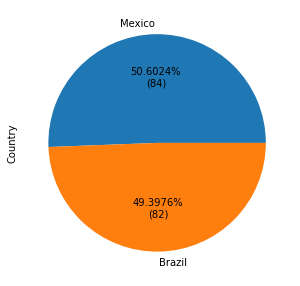

In [67]:
fig = plt.figure(figsize = (10,5))
total = len(julio['Country'])
julio['Country'].value_counts().plot(kind='pie',autopct=my_fmt)

91.56626462936401
8.433734625577927


<AxesSubplot:ylabel='Type of guest'>

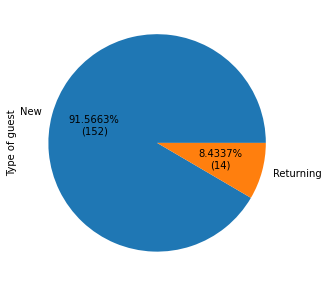

In [68]:
fig = plt.figure(figsize = (10,5))
total = len(julio['Type of guest'])
julio['Type of guest'].value_counts().plot(kind='pie',autopct=my_fmt)

<AxesSubplot:ylabel='Number of nights stayed'>

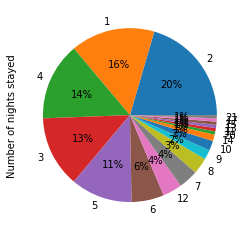

In [69]:
julio['Number of nights stayed'].value_counts().plot(kind='pie',autopct='%1.0f%%')

/usr/local/lib/python3.7/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


<AxesSubplot:xlabel='Number of nights stayed', ylabel='count'>

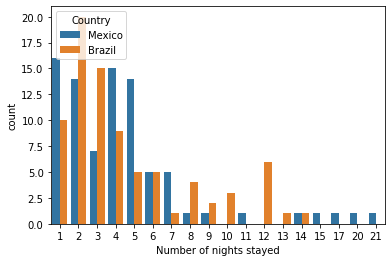

In [70]:
sns.countplot(julio['Number of nights stayed'], hue= julio['Country'])

Text(0.5, 1.0, 'histogram nights stayed')

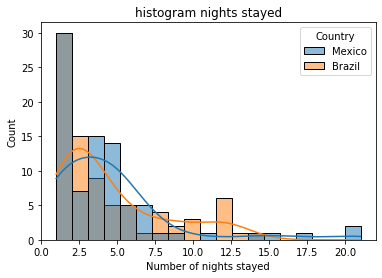

In [71]:
sns.histplot(data=julio, x='Number of nights stayed',kde=True, hue='Country').set_title('histogram nights stayed')

In [72]:
por_dia=pd.pivot_table(data=julio,columns='Country',index='Date of checkout',values='Apartment Number' ,aggfunc='count')

In [73]:
por_dia

Country,Brazil,Mexico
Date of checkout,,
2021-07-01,4,12
2021-07-02,9,12
2021-07-03,5,8
2021-07-04,5,11
2021-07-05,7,7
2021-07-06,1,9
2021-07-07,2,4
2021-07-08,8,3
2021-07-09,9,2


<AxesSubplot:title={'center':'number of check-outs vs date'}, xlabel='Date of checkout'>

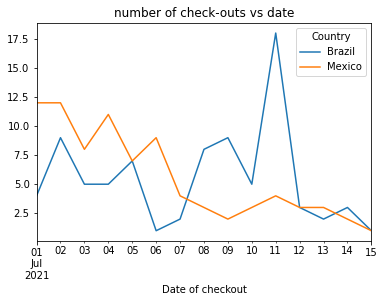

In [74]:
por_dia.plot(title='number of check-outs vs date')

# por edificio

In [75]:
#limpio formato
julio['Stars arrival']=pd.to_numeric(julio['Stars arrival'].fillna('-').apply(limpio))
julio['Stars cleaning']=pd.to_numeric(julio['Stars cleaning'].fillna('-').apply(limpio))
julio['Stars communication']=pd.to_numeric(julio['Stars communication'].fillna('-').apply(limpio))
julio['Stars precision']=pd.to_numeric(julio['Stars precision'].fillna('-').apply(limpio))
julio['Stars value']=pd.to_numeric(julio['Stars value'].fillna('-').apply(limpio))
julio['Stars location']=pd.to_numeric(julio['Stars location'].fillna('-').apply(limpio))


In [76]:
julio

,Public review (translated),Private review (translated),Stars general,Stars arrival,Stars cleaning,Stars communication,Stars precision,Stars value,Stars location,Type of guest,Building Code,Apartment Number,Country,Date of checkout,Number of nights stayed
0,Very good,NaN,4,NaN,NaN,NaN,NaN,NaN,NaN,New,BEF 175,102,Mexico,2021-07-01,3
1,Exceptional! DISLIKED: The iron did not work. ...,NaN,5,NaN,NaN,NaN,NaN,NaN,NaN,New,BEF 175,403,Mexico,2021-07-01,4
2,Excellent,NaN,5,NaN,NaN,NaN,NaN,NaN,NaN,New,CAM 428,4,Mexico,2021-07-01,2
3,Wonderful! We really enjoyed the stay there an...,NaN,5,NaN,NaN,NaN,NaN,NaN,NaN,New,JVM 429,A 11-12,Mexico,2021-07-01,5
4,My favourite Airbnb ever! I loved it! It was m...,NaN,5,5.0,5.0,5.0,5.0,5.0,5.0,New,JVM 429,B 01,Mexico,2021-07-01,7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
161,"Very good location in Polanco neighborhood, wi...",Muchas gracias Rosalia Dawn. I appreciate your...,5,5.0,5.0,5.0,5.0,5.0,5.0,New,PLA 126,201,Mexico,2021-07-14,7
162,Luiz's apartment received us with open arms .....,NaN,5,5.0,5.0,5.0,5.0,5.0,5.0,New,RAI 1400,16,Brazil,2021-07-14,7
163,All very good! Surpassed my expectations and n...,Everything perfect and even better than I expe...,5,5.0,5.0,5.0,5.0,5.0,5.0,Returning,UBR 1577,107,Brazil,2021-07-14,1
164,Everything was wonderful!,NaN,5,5.0,5.0,5.0,5.0,5.0,5.0,New,BEF 175,101,Mexico,2021-07-15,9


In [77]:
edificios=pd.pivot_table(data=julio,columns='Building Code',values=['Country'], 
               aggfunc=('count')).T.rename(columns={'Country':'number of records'})

In [78]:
edificios.sort_values(by='number of records',ascending=False)

,number of records
Building Code,
UBR 1577,62
TON 30,17
JVM 429,10
COR 131,9
PUE 313,8
BEF 175,8
CAM 428,7
TEM 40,7
RPQ 111,6


In [79]:
len(edificios)

24

37.34939694404602
10.240963846445084
6.02409653365612
5.421686917543411
4.819276928901672
4.819276928901672
4.216867312788963
4.216867312788963
3.6144576966762543
2.409638464450836
2.409638464450836
1.8072288483381271
1.8072288483381271
1.8072288483381271
1.204819232225418
1.204819232225418
1.204819232225418
1.204819232225418
1.204819232225418
0.602409616112709
0.602409616112709
0.602409616112709
0.602409616112709
0.602409616112709


<AxesSubplot:ylabel='Building Code'>

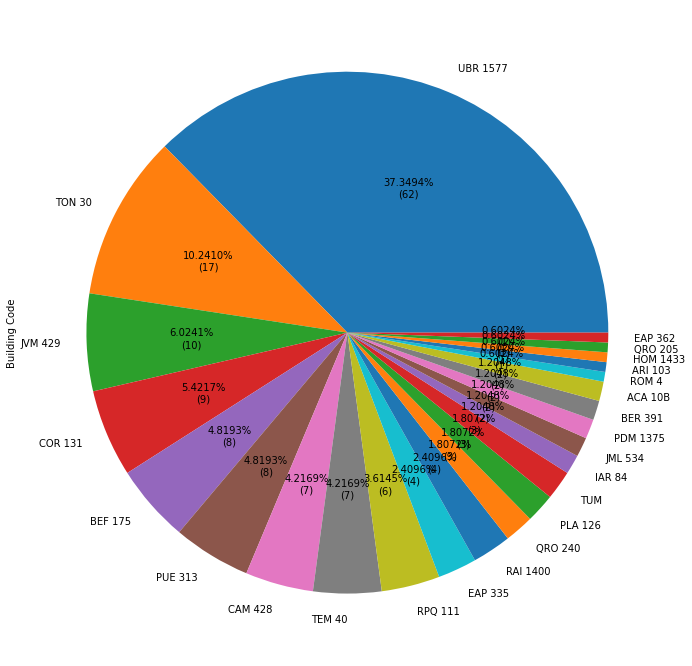

In [80]:
fig = plt.figure(figsize = (12,12))
total = len(julio['Building Code'])
julio['Building Code'].value_counts().plot(kind='pie',autopct=my_fmt)

In [81]:
promedio_std=pd.pivot_table(data=julio,columns='Building Code',values=['Stars general', 'Stars arrival', 'Stars cleaning',
       'Stars communication', 'Stars precision', 'Stars value',
       'Stars location','Number of nights stayed'], 
               aggfunc=('mean','std')).T

promedio_std

Number of nights stayed           Stars arrival            \
                                 mean       std          mean       std   
Building Code                                                             
ACA 10B                      6.500000  2.121320      5.000000  0.000000   
ARI 103                      2.000000       NaN      5.000000       NaN   
BEF 175                      6.875000  4.517822      4.833333  0.408248   
BER 391                      4.000000  2.828427      5.000000  0.000000   
CAM 428                      4.000000  1.825742      4.833333  0.408248   
COR 131                      2.777778  1.715938      5.000000  0.000000   
EAP 335                      2.250000  0.957427      5.000000  0.000000   
EAP 362                      2.000000       NaN      5.000000       NaN   
HOM 1433                     4.000000       NaN      5.000000       NaN   
IAR 84                       2.500000  2.121320      5.000000  0.000000   
JML 534                      5.500000  0.707107      5.000000  0.000000   
JVM 429                      4.900000  6.045200      4.888889  0.333333   
PDM 1375                     2.500000  0.707107      5.000000  0.000000   
PLA 126                      3.666667  2.886751      5.000000  0.000000   
PUE 313                      5.875000  6.010408      5.000000  0.000000   
QRO 205                      4.000000       NaN      5.000000       NaN   
QRO 240                      9.333333  4.163332      4.500000  0.707107   
RAI 1400                     4.000000  2.160247      5.000000  0.000000   
ROM 4                        3.000000       NaN      5.000000       NaN   
RPQ 111                      5.500000  5.244044      5.000000  0.000000   
TEM 40                       2.714286  2.058663      4.333333  1.632993   
TON 30                       4.470588  3.743622      5.000000  0.000000   
TUM                          4.333333  0.577350      5.000000  0.000000   
UBR 1577                     4.532258  3.574581      4.774194  0.525399   

              Stars cleaning           Stars communication            \
                        mean       std                mean       std   
Building Code                                                          
ACA 10B             5.000000  0.000000            5.000000  0.000000   
ARI 103             5.000000       NaN            5.000000       NaN   
BEF 175             4.500000  0.836660            5.000000  0.000000   
BER 391             5.000000  0.000000            5.000000  0.000000   
CAM 428             4.666667  0.516398            5.000000  0.000000   
COR 131             5.000000  0.000000            5.000000  0.000000   
EAP 335             5.000000  0.000000            5.000000  0.000000   
EAP 362             5.000000       NaN            5.000000       NaN   
HOM 1433            4.000000       NaN            5.000000       NaN   
IAR 84              4.500000  0.707107            5.000000  0.000000   
JML 534             4.500000  0.707107            5.000000  0.000000   
JVM 429             4.888889  0.333333            4.888889  0.333333   
PDM 1375            5.000000  0.000000            5.000000  0.000000   
PLA 126             5.000000  0.000000            5.000000  0.000000   
PUE 313             5.000000  0.000000            5.000000  0.000000   
QRO 205             5.000000       NaN            5.000000       NaN   
QRO 240             4.500000  0.707107            5.000000  0.000000   
RAI 1400            4.750000  0.500000            5.000000  0.000000   
ROM 4               5.000000       NaN            5.000000       NaN   
RPQ 111             5.000000  0.000000            5.000000  0.000000   
TEM 40              4.333333  1.632993            4.333333  1.632993   
TON 30              4.647059  0.996317            4.941176  0.242536   
TUM                 4.666667  0.577350            5.000000  0.000000   
UBR 1577            4.725806  0.548302            4.903226  0.348753   

              Stars general           Stars

In [82]:
por_edificio=pd.concat([edificios,promedio_std],axis=1).fillna('just one record').sort_values('number of records',ascending=False)

In [83]:
por_edificio

,number of records,"(Number of nights stayed, mean)","(Number of nights stayed, std)","(Stars arrival, mean)","(Stars arrival, std)","(Stars cleaning, mean)","(Stars cleaning, std)","(Stars communication, mean)","(Stars communication, std)","(Stars general, mean)","(Stars general, std)","(Stars location, mean)","(Stars location, std)","(Stars precision, mean)","(Stars precision, std)","(Stars value, mean)","(Stars value, std)"
Building Code,,,,,,,,,,,,,,,,,
UBR 1577,62,4.532258,3.57458,4.774194,0.525399,4.725806,0.548302,4.903226,0.348753,4.935484,0.247676,4.951613,0.216335,4.854839,0.507219,4.919355,0.328852
TON 30,17,4.470588,3.74362,5.000000,0,4.647059,0.996317,4.941176,0.242536,4.705882,0.848875,4.823529,0.727607,4.588235,1.06412,4.647059,1.05719
JVM 429,10,4.900000,6.0452,4.888889,0.333333,4.888889,0.333333,4.888889,0.333333,5.000000,0,4.777778,0.440959,5.000000,0,5.000000,0
COR 131,9,2.777778,1.71594,5.000000,0,5.000000,0,5.000000,0,5.000000,0,5.000000,0,5.000000,0,5.000000,0
PUE 313,8,5.875000,6.01041,5.000000,0,5.000000,0,5.000000,0,4.875000,0.353553,5.000000,0,5.000000,0,5.000000,0
BEF 175,8,6.875000,4.51782,4.833333,0.408248,4.500000,0.83666,5.000000,0,4.750000,0.46291,5.000000,0,4.833333,0.408248,5.000000,0
CAM 428,7,4.000000,1.82574,4.833333,0.408248,4.666667,0.516398,5.000000,0,5.000000,0,5.000000,0,4.833333,0.408248,5.000000,0
TEM 40,7,2.714286,2.05866,4.333333,1.63299,4.333333,1.63299,4.333333,1.63299,4.000000,1.73205,5.000000,0,5.000000,0,4.333333,1.63299
RPQ 111,6,5.500000,5.24404,5.000000,0,5.000000,0,5.000000,0,5.000000,0,5.000000,0,5.000000,0,5.000000,0


In [84]:
#exporto
por_edificio.to_excel('por_edificio.xlsx')

In [85]:
promedio=pd.pivot_table(data=julio,columns='Building Code',values=['Stars general', 'Stars arrival', 'Stars cleaning',
       'Stars communication', 'Stars precision', 'Stars value',
       'Stars location','Number of nights stayed'], 
               aggfunc=('mean')).T

In [86]:
promedio

,Number of nights stayed,Stars arrival,Stars cleaning,Stars communication,Stars general,Stars location,Stars precision,Stars value
Building Code,,,,,,,,
ACA 10B,6.500000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000
ARI 103,2.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000
BEF 175,6.875000,4.833333,4.500000,5.000000,4.750000,5.000000,4.833333,5.000000
BER 391,4.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,3.500000
CAM 428,4.000000,4.833333,4.666667,5.000000,5.000000,5.000000,4.833333,5.000000
COR 131,2.777778,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000
EAP 335,2.250000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000
EAP 362,2.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000
HOM 1433,4.000000,5.000000,4.000000,5.000000,5.000000,5.000000,5.000000,5.000000


In [87]:
edificio_promedio=pd.concat([edificios,promedio],axis=1).fillna('just one record').sort_values('number of records',ascending=False)

In [88]:
edificio_promedio

,number of records,Number of nights stayed,Stars arrival,Stars cleaning,Stars communication,Stars general,Stars location,Stars precision,Stars value
Building Code,,,,,,,,,
UBR 1577,62,4.532258,4.774194,4.725806,4.903226,4.935484,4.951613,4.854839,4.919355
TON 30,17,4.470588,5.000000,4.647059,4.941176,4.705882,4.823529,4.588235,4.647059
JVM 429,10,4.900000,4.888889,4.888889,4.888889,5.000000,4.777778,5.000000,5.000000
COR 131,9,2.777778,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000
PUE 313,8,5.875000,5.000000,5.000000,5.000000,4.875000,5.000000,5.000000,5.000000
BEF 175,8,6.875000,4.833333,4.500000,5.000000,4.750000,5.000000,4.833333,5.000000
CAM 428,7,4.000000,4.833333,4.666667,5.000000,5.000000,5.000000,4.833333,5.000000
TEM 40,7,2.714286,4.333333,4.333333,4.333333,4.000000,5.000000,5.000000,4.333333
RPQ 111,6,5.500000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000


In [89]:
#promedio
edificio_promedio.to_excel('promedio_edificio.xlsx')

In [90]:
#std
sigma=pd.pivot_table(data=julio,columns='Building Code',values=['Stars general', 'Stars arrival', 'Stars cleaning',
       'Stars communication', 'Stars precision', 'Stars value',
       'Stars location','Number of nights stayed'], 
               aggfunc=('std')).T

In [91]:
edificio_sigma=pd.concat([edificios,sigma],axis=1).fillna('only one').sort_values('number of records',ascending=False)

In [92]:
edificio_sigma

,number of records,Number of nights stayed,Stars arrival,Stars cleaning,Stars communication,Stars general,Stars location,Stars precision,Stars value
UBR 1577,62,3.57458,0.525399,0.548302,0.348753,0.247676,0.216335,0.507219,0.328852
TON 30,17,3.74362,0,0.996317,0.242536,0.848875,0.727607,1.06412,1.05719
JVM 429,10,6.0452,0.333333,0.333333,0.333333,0,0.440959,0,0
COR 131,9,1.71594,0,0,0,0,0,0,0
PUE 313,8,6.01041,0,0,0,0.353553,0,0,0
BEF 175,8,4.51782,0.408248,0.83666,0,0.46291,0,0.408248,0
CAM 428,7,1.82574,0.408248,0.516398,0,0,0,0.408248,0
TEM 40,7,2.05866,1.63299,1.63299,1.63299,1.73205,0,0,1.63299
RPQ 111,6,5.24404,0,0,0,0,0,0,0
EAP 335,4,0.957427,0,0,0,0,0,0,0


In [93]:
#exporto
edificio_sigma.to_excel('sigma.xlsx')

In [94]:
lista_df=[]
lista_clouds=[]
for i in lista_edificios:
    df=julio[julio['Building Code']==i]
    
    texto_privado=list(julio['Public review (translated)'].apply(str).values+'*= '+julio['Stars general'].apply(str).values)
    texto_publico=list(julio['Private review (translated)'].apply(str).values+'*= '+julio['Stars general'].apply(str).values)
    
    public_status=[]
    for k in texto_publico:
        j=TextBlob(k).sentiment
        if j.polarity==0:
            public_status.append('neutral')
        elif j.polarity<0:
            public_status.append('negative')
        elif j.polarity>0:
            public_status.append('positive')
            
    private_status=[]
    for n in texto_privado:
        m=TextBlob(n).sentiment
        if m.polarity==0:
            private_status.append('neutral')
        elif m.polarity<0:
            private_status.append('negative')
        elif m.polarity>0:
            private_status.append('positive')
    
    nuevo_df=pd.DataFrame()
    
    nuevo_df['Public review (translated)']=texto_publico
    nuevo_df['polarity_public']=public_status
    nuevo_df['Private review (translated)']=texto_privado
    nuevo_df['polarity_private']=private_status
    
    nuevo_df['Building code']=i
    
    lista_df.append(nuevo_df)
    
    
    

In [95]:
evaluaciones=pd.concat(lista_df)

In [96]:
evaluaciones

,Public review (translated),polarity_public,Private review (translated),polarity_private,Building code
0,nan*= 4,neutral,Very good *= 4,positive,UBR 1577
1,nan*= 5,neutral,Exceptional! DISLIKED: The iron did not work. ...,positive,UBR 1577
2,nan*= 5,neutral,Excellent*= 5,positive,UBR 1577
3,nan*= 5,neutral,Wonderful! We really enjoyed the stay there an...,positive,UBR 1577
4,nan*= 5,neutral,My favourite Airbnb ever! I loved it! It was m...,positive,UBR 1577
...,...,...,...,...,...
161,Muchas gracias Rosalia Dawn. I appreciate your...,neutral,"Very good location in Polanco neighborhood, wi...",positive,EAP 362
162,nan*= 5,neutral,Luiz's apartment received us with open arms .....,positive,EAP 362
163,Everything perfect and even better than I expe...,positive,All very good! Surpassed my expectations and n...,positive,EAP 362
164,nan*= 5,neutral,Everything was wonderful!*= 5,positive,EAP 362


In [97]:
for i in evaluaciones['Private review (translated)']:
    if re.search('floor',i):
        print(i, '\n')

This is a perfect place for a solo traveler. It was very cost effective and the space is perfectly optimized. I was able to cook and the couch is good enough for one. The bed is large and comfortable. The temperature was decently regulated even without a/c. The TV has Netflix. There is a shared area on each floor with a room with a washer/dryer, but you have to provide your own detergent. There is a open area that is good for working during the day. It is also perfectly situated in Roma Norte. The metro stop is nearby. There are countless cafes, restaurants, and exercise options within walking distance. Casai does a great job of automation for checkin and check out so that process is seamless. The only negatives were road noise at night and flimsy doors but there are earplugs provided and good security at the main point of entrance.*= 5 

Strengths: excellent structure! Quick host responses. Super convenient check-in and check-out. Negative point: the apartment wasn't super clean, coul

In [98]:
#exporto
evaluaciones.to_excel('evaluaciones.xlsx')

In [99]:
lista_polar=['positive','negative','neutral']

In [100]:
lista_nubes=[]
for i in lista_edificios:
    for j in lista_polar:
        df1=evaluaciones[(evaluaciones['Building code']==i)&(evaluaciones['polarity_public']==j)]
        
        nube1= WordCloud().generate(" ".join(list(df1['Public review (translated)'].values)))
        lista_nubes.append(['public review '+i+' '+j,nube1])
        
        nube2= WordCloud().generate(" ".join(list(df1['Private review (translated)'].values)))
        lista_nubes.append(['private review '+i+' '+j,nube2])
        
        
        
                                

In [101]:
%%javascript
IPython.OutputArea.auto_scroll_threshold = 9999;

<IPython.core.display.Javascript object>

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.


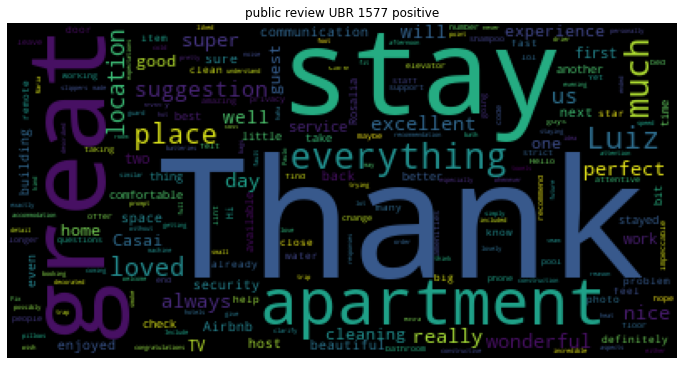

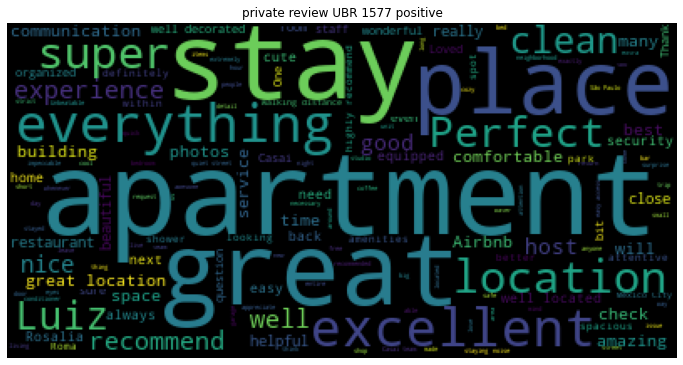

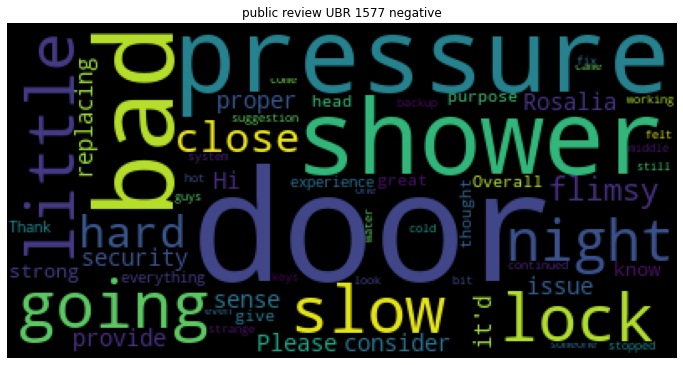

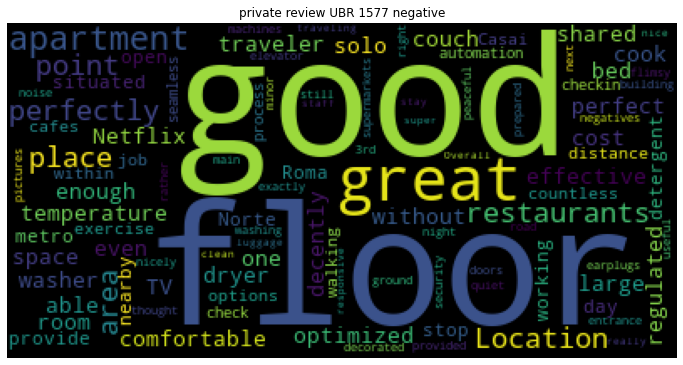

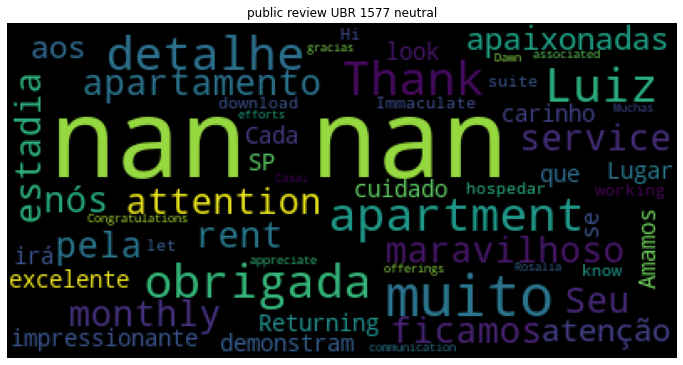

...

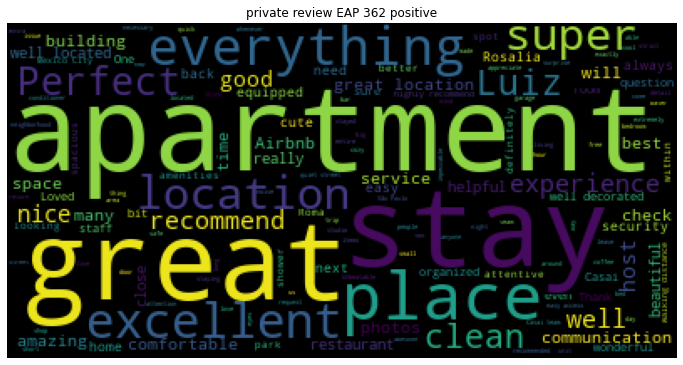

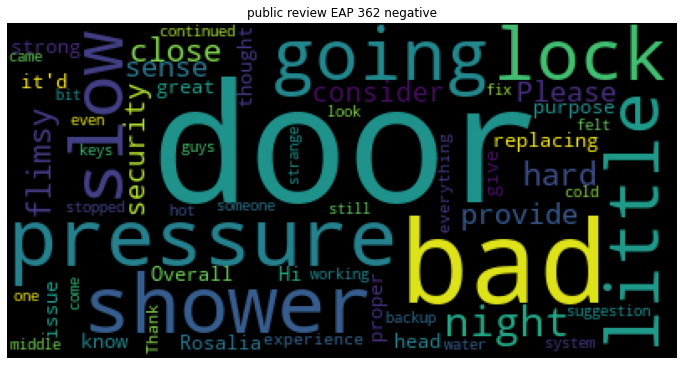

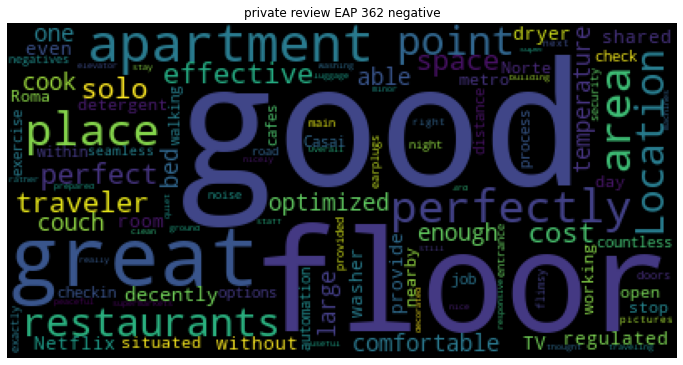

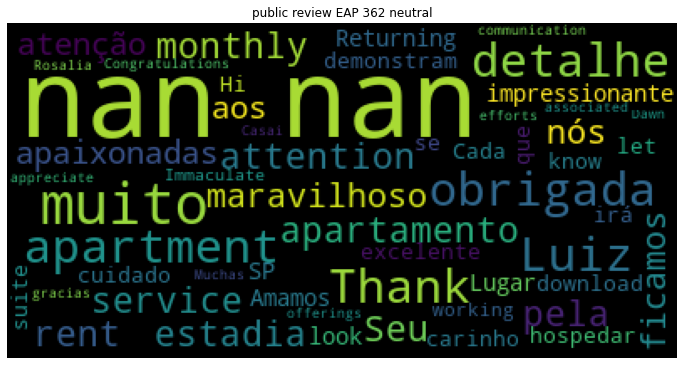

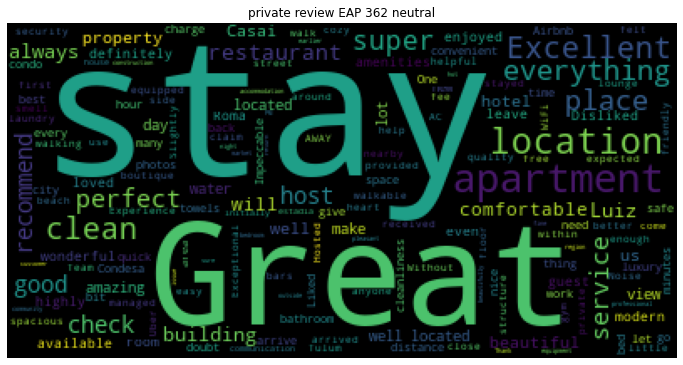

In [102]:

for i in range(len(lista_nubes)):
    nombre=lista_nubes[i][0]
    #i[0][1]
    plt.figure(figsize = (12,12))

    plt.imshow(lista_nubes[i][1])

    plt.axis('off')
    plt.title(nombre)
    plt.savefig('out/'+nombre+'.jpeg')
    
    

In [103]:
otros_edificios=lista_edificios[9:]

In [104]:
otros_edificios

['EAP 335',
 'RAI 1400',
 'QRO 240',
 'PLA 126',
 'TUM',
 'IAR 84',
 'JML 534',
 'PDM 1375',
 'BER 391',
 'ACA 10B',
 'ROM 4',
 'ARI 103',
 'HOM 1433',
 'QRO 205',
 'EAP 362']

In [105]:
lista_otras_nubes=[]

for j in lista_polar:
    otros_1=evaluaciones[(evaluaciones['Building code'].isin(otros_edificios))&(evaluaciones['polarity_public']==j)]
        
    nube1= WordCloud().generate(" ".join(list(otros_1['Public review (translated)'].values)))
    lista_otras_nubes.append(['public review '+j,nube1])
        
    nube2= WordCloud().generate(" ".join(list(otros_1['Private review (translated)'].values)))
    lista_otras_nubes.append(['private review '+j,nube2])

In [106]:
lista_otras_nubes

[['public review positive', <wordcloud.wordcloud.WordCloud at 0x12ecbb8d0>],
 ['private review positive', <wordcloud.wordcloud.WordCloud at 0x12df4a190>],
 ['public review negative', <wordcloud.wordcloud.WordCloud at 0x12e291190>],
 ['private review negative', <wordcloud.wordcloud.WordCloud at 0x12e1c1090>],
 ['public review neutral', <wordcloud.wordcloud.WordCloud at 0x12deb8250>],
 ['private review neutral', <wordcloud.wordcloud.WordCloud at 0x130931550>]]

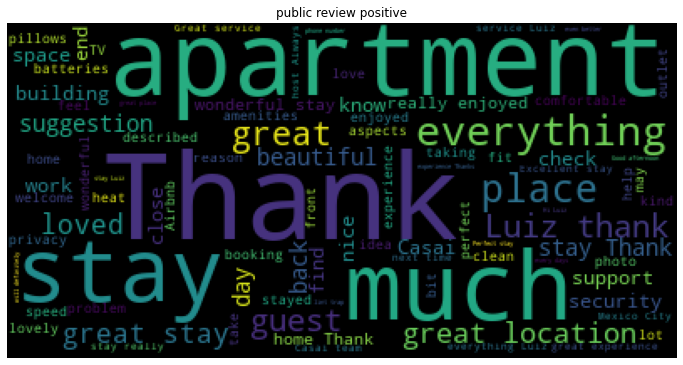

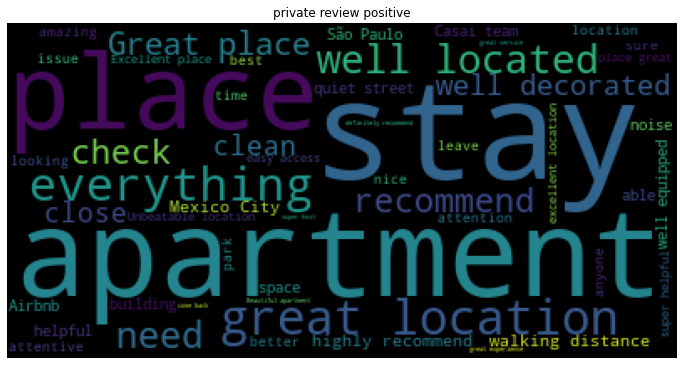

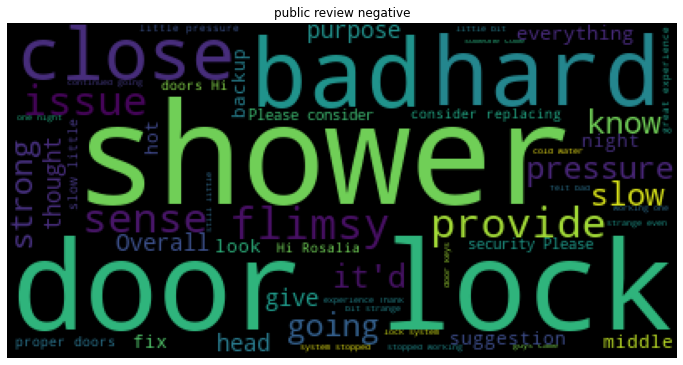

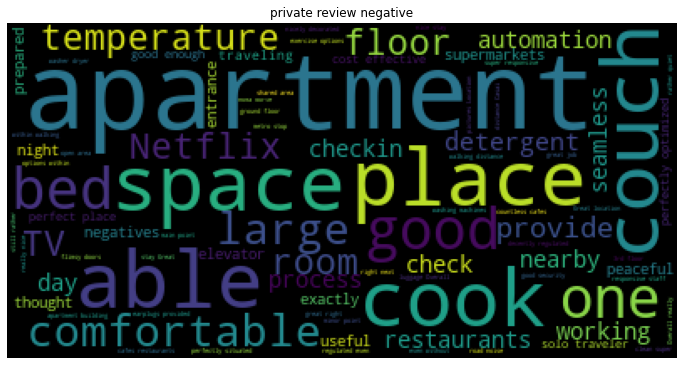

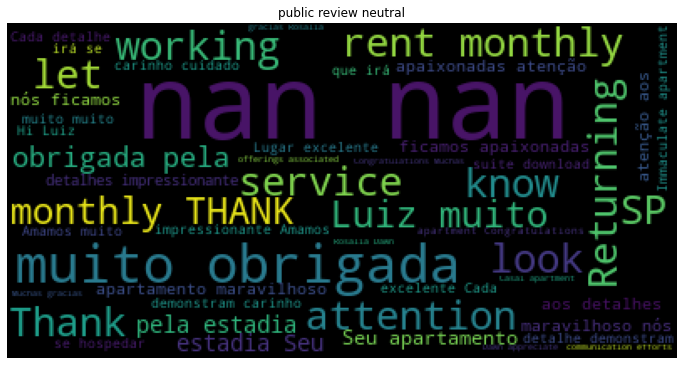

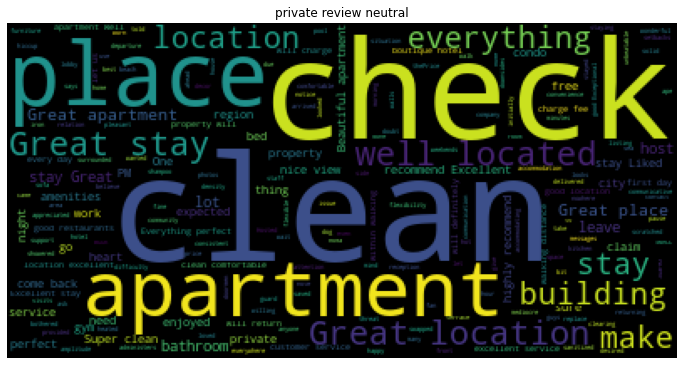

In [107]:
for i in range(len(lista_otras_nubes)):
    nombre=lista_otras_nubes[i][0]
    #i[0][1]
    plt.figure(figsize = (12,12))

    plt.imshow(lista_otras_nubes[i][1])

    plt.axis('off')
    plt.title(nombre)

# pdf

In [108]:
archivo='CX Associate - CASAI & Jane Smith _ CX 2021.pdf'

In [109]:
discusion=textract.process(archivo)

In [110]:
encoding='utf-8'
disc_txt=discusion.decode(encoding)

In [111]:
oraciones=re.split(r"[~\r\n]+",disc_txt)

In [112]:
oraciones

['Please review this conversation with care and note that this information should not be shared with anyone',
 'outside Casai. Safe to share with candidates.',
 'CASAI <> Jane Smith',
 'This is a conversation between Casai and a guest that stayed with us last year. For privacy',
 'reasons, we changed her name to Jane Smith. Feel free to review and take notes on important',
 'things you notice across this information exchange.',
 'AUTOMATED MESSAGE',
 'Hi Jane Smith,',
 'Thank you so much for booking my place!',
 'Your check-in is on: Jul 16th, 2020',
 'Your check-out is on: Jul 31st, 2020',
 "For your upcoming reservation: Please let me know if you're coming with extra guests, as well as their names for",
 'registration at check-in.',
 "You'll receive check-in instructions to the apartment tomorrow. Let me know if you have any questions!",
 '---',
 'Hola Jane Smith,',
 '¡Muchas gracias por reservar mi espacio!',
 'Tu check-in es: Jul 16th, 2020',
 'Tu check-out es: Jul 31st, 2020',
 'P

In [113]:
texto_nuevo=[]
for i in oraciones:
    j=(TextBlob(i).sentiment)
    if j.polarity==0:
        texto_nuevo.append(i+' neutral')
    elif j.polarity<0:
        texto_nuevo.append(i+' negative')
    elif j.polarity>0:
        texto_nuevo.append(i+' positive')

In [114]:
texto_nuevo

['Please review this conversation with care and note that this information should not be shared with anyone neutral',
 'outside Casai. Safe to share with candidates. positive',
 'CASAI <> Jane Smith neutral',
 'This is a conversation between Casai and a guest that stayed with us last year. For privacy neutral',
 'reasons, we changed her name to Jane Smith. Feel free to review and take notes on important positive',
 'things you notice across this information exchange. neutral',
 'AUTOMATED MESSAGE neutral',
 'Hi Jane Smith, neutral',
 'Thank you so much for booking my place! positive',
 'Your check-in is on: Jul 16th, 2020 neutral',
 'Your check-out is on: Jul 31st, 2020 neutral',
 "For your upcoming reservation: Please let me know if you're coming with extra guests, as well as their names for neutral",
 'registration at check-in. neutral',
 "You'll receive check-in instructions to the apartment tomorrow. Let me know if you have any questions! neutral",
 '--- neutral',
 'Hola Jane Smith